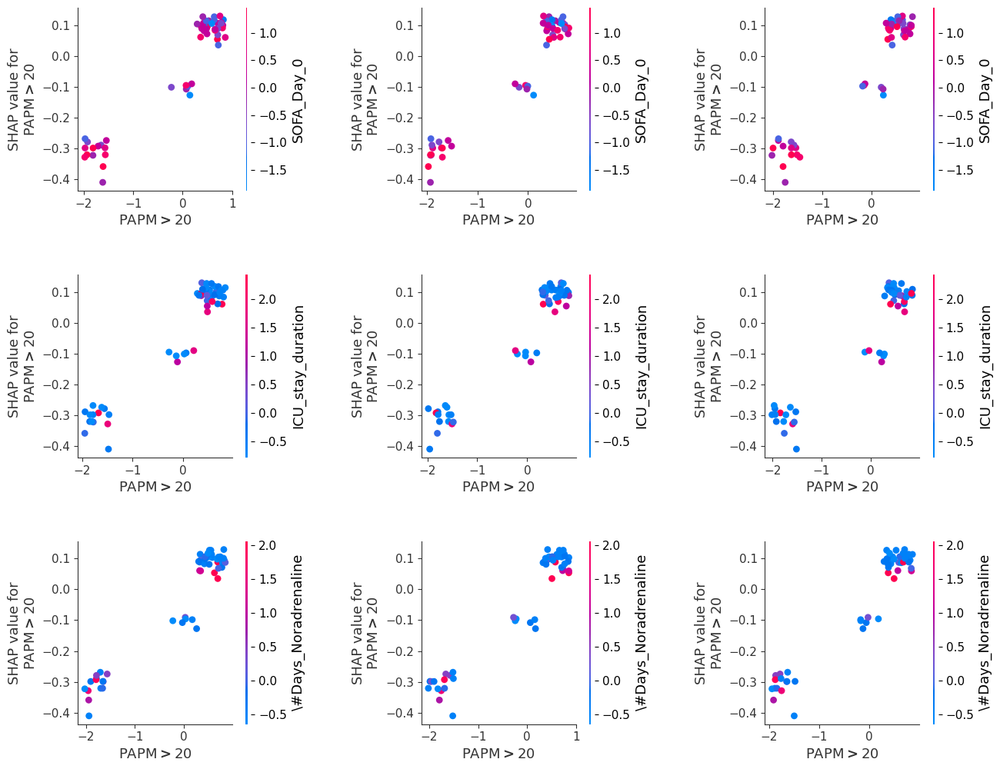

In [226]:
# we can use shap.approximate_interactions to guess which features
# may interact with rejet_humoral_dans_l'année
from matplotlib import gridspec
inds = shap.approximate_interactions("PAPM$>$20", shap_values_0, X_valid_S)

# make plots colored by each of the top three possible interacting features
#ax = tuple(['ax'+str(x) for x in range(9)])
    
#fig, ax = plt.subplots(3,3, figsize=(16, 9))
fig = plt.figure(tight_layout=True, figsize=(14,11))
spec = gridspec.GridSpec(ncols=3, nrows=3, figure=fig)

for i in range(3):
    for j in range(3):
      ax = fig.add_subplot(spec[i, j])
      shap.dependence_plot("PAPM$>$20", shap_values_0, X_valid_S, interaction_index=inds[i], 
                          x_jitter=1, dot_size=40, ax=ax, show=False)
    
# Save the figure as a PDF file
fig.savefig('shap_interactions_PAPM$>$20_2.pdf', dpi=300, bbox_inches='tight')    
        
plt.tight_layout()
plt.show()

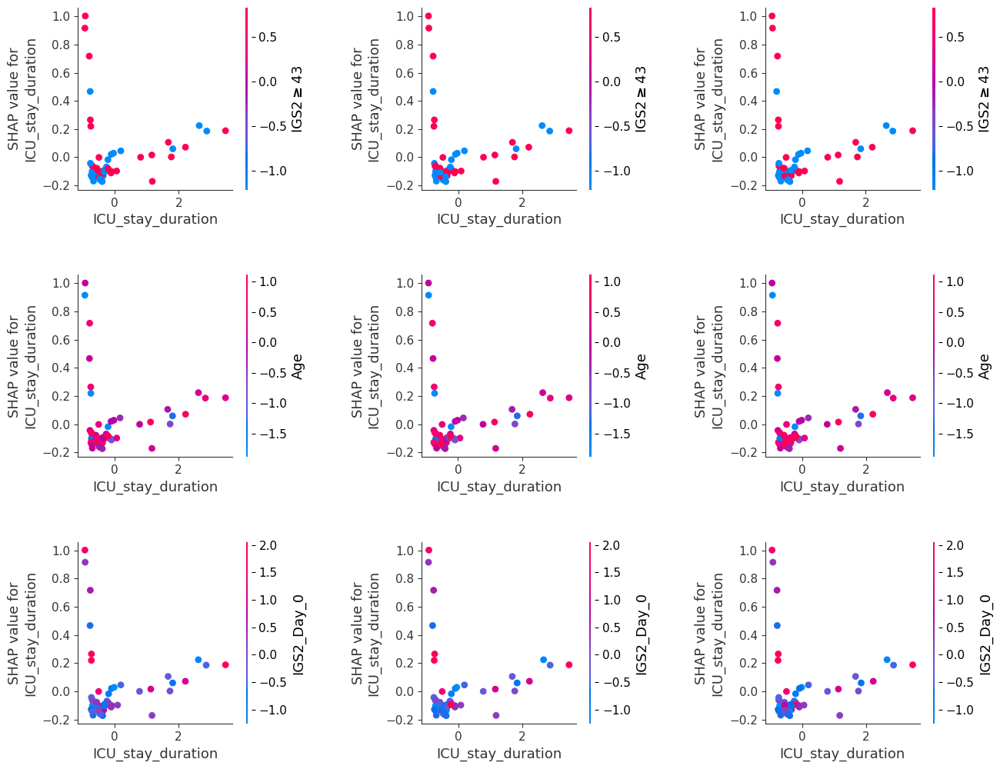

In [227]:
# we can use shap.approximate_interactions to guess which features
# may interact with rejet_humoral_dans_l'année
from matplotlib import gridspec
inds = shap.approximate_interactions("ICU_stay_duration", shap_values_0, X_valid_S)

# make plots colored by each of the top three possible interacting features
#ax = tuple(['ax'+str(x) for x in range(9)])
    
#fig, ax = plt.subplots(3,3, figsize=(16, 9))
fig = plt.figure(tight_layout=True, figsize=(14,11))
spec = gridspec.GridSpec(ncols=3, nrows=3, figure=fig)

for i in range(3):
    for j in range(3):
      ax = fig.add_subplot(spec[i, j])
      shap.dependence_plot("ICU_stay_duration", shap_values_0, X_valid_S, interaction_index=inds[i], 
                          x_jitter=1, dot_size=40, ax=ax, show=False)
 
# Save the figure as a PDF file
fig.savefig('shap_interactions_ICU_stay_duration_2.pdf', dpi=300, bbox_inches='tight')    
        
plt.tight_layout()
plt.show()

This code generates a set of SHAP dependence plots to visualize the approximate interactions between the "ICU_stay_duration" feature and the top three features that may interact with it in a machine learning model.

The SHAP (SHapley Additive exPlanations) library is used to calculate the SHAP values for each feature, which represent the contribution of each feature to the final prediction of the model. The shap_values_0 and X_valid_S variables likely contain the SHAP values and input data used to generate the plots.

The shap.approximate_interactions function is used to estimate the interaction strengths between the "ICU_stay_duration" feature and all the other features in the dataset. The top three features with the strongest interactions are selected, and a set of SHAP dependence plots is generated for each of these three features.

Each plot shows how the "ICU_stay_duration" feature affects the prediction of the model for different values of the selected interacting feature. The interaction effect is represented by the color of the points in the plot, and the vertical position of the points represents the SHAP value of the "ICU_stay_duration" feature. The interaction_index parameter in the shap.dependence_plot function specifies which feature to plot the interaction with.

Finally, the plots are saved as a PDF file named "shap_interactions_ICU_stay_duration.pdf" and displayed on the screen.

The code generates a 3x3 grid of plots, with each row showing the dependence of the model prediction on the "ICU_stay_duration" feature for a different interacting feature. The three columns in each row correspond to the different values of the interacting feature.

For example, if the top three interacting features are "age", "heart rate", and "temperature", then the first row of the plot would show the interaction between "ICU_stay_duration" and "age" in the three columns, where each column represents a different range of ages. The second row would show the interaction between "ICU_stay_duration" and "heart rate" in the three columns, where each column represents a different range of heart rates. The third row would show the interaction between "ICU_stay_duration" and "temperature" in the three columns, where each column represents a different range of temperatures.

In each plot, the y-axis represents the SHAP value for "ICU_stay_duration", while the x-axis represents the values of the interacting feature. The color of the points in the plot represents the interaction effect between "ICU_stay_duration" and the corresponding interacting feature.

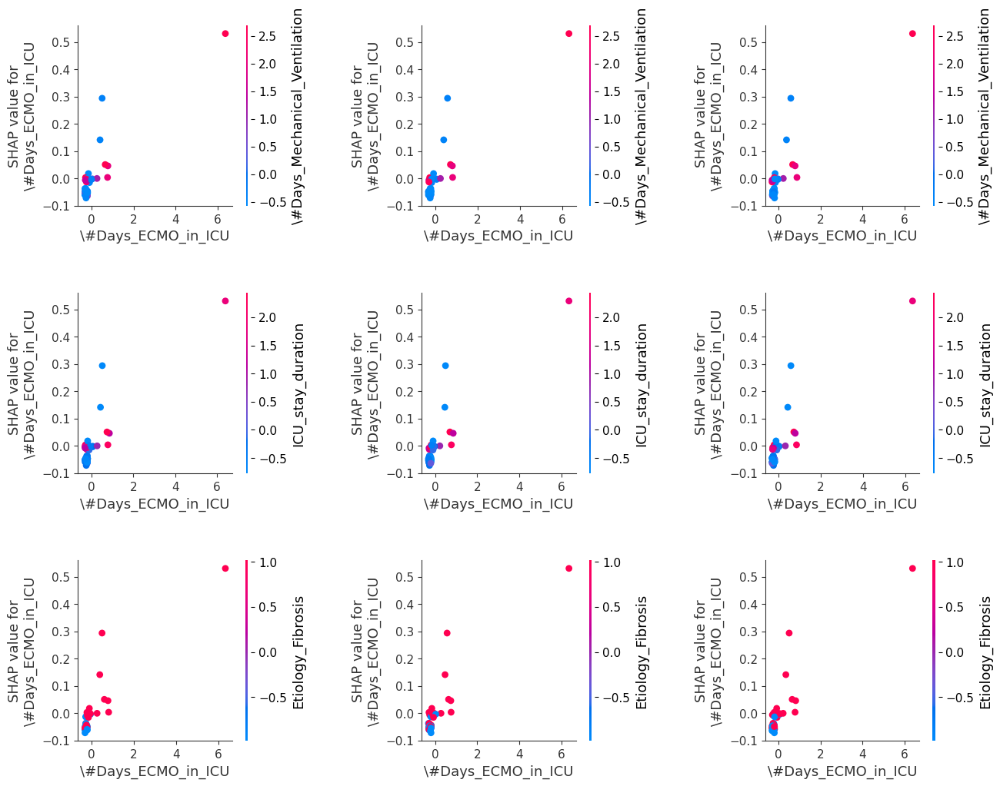

In [228]:
# we can use shap.approximate_interactions to guess which features
# may interact with #Days_ECMO_in_ICU
from matplotlib import gridspec
inds = shap.approximate_interactions("\#Days_ECMO_in_ICU", shap_values_0, X_valid_S)

# make plots colored by each of the top three possible interacting features
#ax = tuple(['ax'+str(x) for x in range(9)])
    
#fig, ax = plt.subplots(3,3, figsize=(16, 9))
fig = plt.figure(tight_layout=True, figsize=(14,11))
spec = gridspec.GridSpec(ncols=3, nrows=3, figure=fig)

for i in range(3):
    for j in range(3):
      ax = fig.add_subplot(spec[i, j])
      shap.dependence_plot("\#Days_ECMO_in_ICU", shap_values_0, X_valid_S, interaction_index=inds[i], 
                          x_jitter=1, dot_size=40, ax=ax, show=False)

# Save the figure as a PDF file
fig.savefig('shap_interactions_\#Days_ECMO_in_ICU_2.pdf', dpi=300, bbox_inches='tight')    
        
plt.tight_layout()
plt.show()

In [532]:
def cohen_effect_size(X, y):
    """Calculates the Cohen effect size of each feature.
    
        Parameters
        ----------
        X : {array-like, sparse matrix}, shape = [n_samples, n_features]
            Training vector, where n_samples in the number of samples and
            n_features is the number of features.
        y : array-like, shape = [n_samples]
            Target vector relative to X
        Returns
        -------
        cohen_effect_size : array, shape = [n_features,]
            The set of Cohen effect values.
        Notes
        -----
        Based on https://github.com/AllenDowney/CompStats/blob/master/effect_size.ipynb
    """
    group1, group2 = X[y==0], X[y==1]
    diff = group1.mean() - group2.mean()
    var1, var2 = group1.var(), group2.var()
    n1, n2 = group1.shape[0], group2.shape[0]
    pooled_var = (n1 * var1 + n2 * var2) / (n1 + n2)
    d = diff / np.sqrt(pooled_var)
    return d

In [538]:
df2_standard_scale.iloc[:,0:48].columns

Index(['Age', 'Age$\geq$60', 'Sex(0=F,1=M)', 'BMI(body_mass_index)',
       'BMI$<$18', 'BMI$>$30', 'BMI$>$25', 'Ischemic_heart_disease',
       'Pre-operative_diabetes', 'PAPM(mean_pulmonary_arterial_pressure)',
       'PAPM$>$20', 'Etiology_BPCO', 'Etiology_Fibrosis', 'Other_etiologies',
       'CMV_Mismatch', 'Pre-operative_ECMO', 'Super_Urgency',
       'Type_of_TP(0=single_lung,1=double_lung)', 'Max_Cold_Ischemia',
       'Max_Cold_Ischemia$>$6h', 'Peridural_Analgesia', 'Perioperative_ECMO',
       'Peroperative_Transfusion$>$2U', 'SOFA_Day_0', 'SOFA$\geq$7',
       'IGS2_Day_0', 'IGS2$\geq$43', '\#Days_Noradrenaline',
       '\#Days_Noradrenaline$\geq$2', '\#Days_Mechanical_Ventilation',
       '\#Days_Mechanical_Ventilation$\geq$3', 'ECMO_in_ICU',
       '\#Days_ECMO_in_ICU', '\#Days_ECMO_in_ICU$\geq$1',
       'Primary_Graft_Dysfunction_grade_3', 'Acute_Renal_Failure',
       'Dialysis_in_ICU', 'Bacteremia', 'Pneumonia(all_germs)',
       'Pneumonia_with_BLSE_and/or_abscess_in_

In [568]:
y.values

array([0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1,
       0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0,
       0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1,
       1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0,
       0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0,
       0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1,
       1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0,
       0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1,
       1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0,
       0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0,
       0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0,
       0, 0, 0, 1, 0, 0, 0, 0, 0, 0])

In [569]:
print('Number of features %d' % len(df2_standard_scale.iloc[:,0:48].columns))
effect_sizes = cohen_effect_size(df2_standard_scale.iloc[:,0:48][df2_standard_scale.iloc[:,0:48].columns], y)

Number of features 48


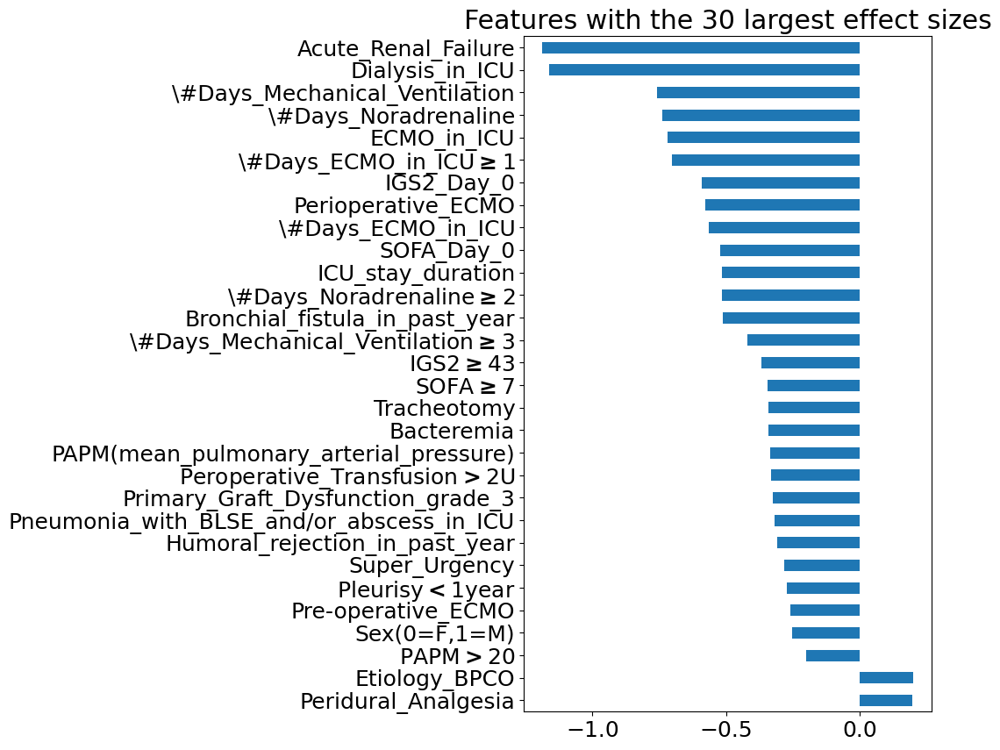

In [577]:
effect_sizes.reindex(effect_sizes.abs().sort_values(ascending=False).nlargest(30).index)[::-1].plot.barh(figsize=(6, 10));
plt.rcParams.update({'font.size': 18, "font.weight": "normal"}); 
plt.title('Features with the 30 largest effect sizes');
#fig, ax = plt.subplots(figsize=(8,6))
plt.savefig('Cohen_largest effect sizes.pdf', dpi=300, bbox_inches='tight')

In [312]:
significant_features = [f for f in X.columns if np.abs(effect_sizes.loc[f]) > 0.1]
print('Significant features %d: %s' % (len(significant_features), significant_features))

Significant features 38: ['Sex(0=F,1=M)', 'BMI(body_mass_index)', 'BMI$>$30', 'BMI$>$25', 'Pre-operative_diabetes', 'PAPM(mean_pulmonary_arterial_pressure)', 'PAPM$>$20', 'Etiology_BPCO', 'Other_etiologies', 'CMV_Mismatch', 'Pre-operative_ECMO', 'Super_Urgency', 'Max_Cold_Ischemia', 'Peridural_Analgesia', 'Perioperative_ECMO', 'Peroperative_Transfusion$>$2U', 'SOFA_Day_0', 'SOFA$\\geq$7', 'IGS2_Day_0', 'IGS2$\\geq$43', '\\#Days_Noradrenaline', '\\#Days_Noradrenaline$\\geq$2', '\\#Days_Mechanical_Ventilation', '\\#Days_Mechanical_Ventilation$\\geq$3', 'ECMO_in_ICU', '\\#Days_ECMO_in_ICU', '\\#Days_ECMO_in_ICU$\\geq$1', 'Primary_Graft_Dysfunction_grade_3', 'Acute_Renal_Failure', 'Dialysis_in_ICU', 'Bacteremia', 'Pneumonia_with_BLSE_and/or_abscess_in_ICU', 'Tracheotomy', 'Bronchial_fistula_in_past_year', 'Humoral_rejection_in_past_year', 'Pleurisy$<$1year', 'ICU_stay_duration', 'ICU_stay_duration$\\geq$15days']


In [313]:
X2 = X[significant_features].fillna(0)

In [314]:
from catboost import CatBoostClassifier
catb_model2 = CatBoostClassifier(random_state=42)
catb_model2.fit(X2, y)
shap_valuesTT = shap.TreeExplainer(catb_model2).shap_values(X2)

Learning rate set to 0.005719
0:	learn: 0.6895683	total: 20ms	remaining: 20s
1:	learn: 0.6855612	total: 28.3ms	remaining: 14.1s
2:	learn: 0.6823118	total: 31.4ms	remaining: 10.4s
3:	learn: 0.6785484	total: 34.2ms	remaining: 8.51s
4:	learn: 0.6756471	total: 38.6ms	remaining: 7.68s
5:	learn: 0.6717793	total: 40.5ms	remaining: 6.71s
6:	learn: 0.6691454	total: 42.4ms	remaining: 6.01s
7:	learn: 0.6656855	total: 44.2ms	remaining: 5.47s
8:	learn: 0.6620574	total: 49ms	remaining: 5.39s
9:	learn: 0.6590701	total: 50.7ms	remaining: 5.02s
10:	learn: 0.6561393	total: 52.5ms	remaining: 4.72s
11:	learn: 0.6523626	total: 54.3ms	remaining: 4.47s
12:	learn: 0.6498757	total: 56.2ms	remaining: 4.26s
13:	learn: 0.6462074	total: 58.1ms	remaining: 4.09s
14:	learn: 0.6427597	total: 59.8ms	remaining: 3.93s
15:	learn: 0.6402916	total: 61.6ms	remaining: 3.79s
16:	learn: 0.6373980	total: 63.5ms	remaining: 3.67s
17:	learn: 0.6343642	total: 65.2ms	remaining: 3.56s
18:	learn: 0.6314994	total: 67.9ms	remaining: 3.5s

258:	learn: 0.3275583	total: 561ms	remaining: 1.6s
259:	learn: 0.3271740	total: 563ms	remaining: 1.6s
260:	learn: 0.3266833	total: 565ms	remaining: 1.6s
261:	learn: 0.3260909	total: 567ms	remaining: 1.6s
262:	learn: 0.3255500	total: 569ms	remaining: 1.59s
263:	learn: 0.3249418	total: 570ms	remaining: 1.59s
264:	learn: 0.3245681	total: 573ms	remaining: 1.59s
265:	learn: 0.3237580	total: 575ms	remaining: 1.59s
266:	learn: 0.3233418	total: 578ms	remaining: 1.59s
267:	learn: 0.3224273	total: 580ms	remaining: 1.58s
268:	learn: 0.3221817	total: 582ms	remaining: 1.58s
269:	learn: 0.3215964	total: 584ms	remaining: 1.58s
270:	learn: 0.3211005	total: 586ms	remaining: 1.57s
271:	learn: 0.3204357	total: 588ms	remaining: 1.57s
272:	learn: 0.3201755	total: 590ms	remaining: 1.57s
273:	learn: 0.3195293	total: 591ms	remaining: 1.57s
274:	learn: 0.3189689	total: 593ms	remaining: 1.56s
275:	learn: 0.3185189	total: 595ms	remaining: 1.56s
276:	learn: 0.3180128	total: 597ms	remaining: 1.56s
277:	learn: 0.31

476:	learn: 0.2451395	total: 941ms	remaining: 1.03s
477:	learn: 0.2449452	total: 943ms	remaining: 1.03s
478:	learn: 0.2445733	total: 945ms	remaining: 1.03s
479:	learn: 0.2440603	total: 947ms	remaining: 1.02s
480:	learn: 0.2435908	total: 948ms	remaining: 1.02s
481:	learn: 0.2433883	total: 949ms	remaining: 1.02s
482:	learn: 0.2431722	total: 951ms	remaining: 1.02s
483:	learn: 0.2426588	total: 952ms	remaining: 1.01s
484:	learn: 0.2424370	total: 953ms	remaining: 1.01s
485:	learn: 0.2421412	total: 955ms	remaining: 1.01s
486:	learn: 0.2417504	total: 956ms	remaining: 1.01s
487:	learn: 0.2413953	total: 958ms	remaining: 1s
488:	learn: 0.2412591	total: 959ms	remaining: 1s
489:	learn: 0.2409768	total: 961ms	remaining: 1s
490:	learn: 0.2406207	total: 963ms	remaining: 998ms
491:	learn: 0.2403594	total: 965ms	remaining: 996ms
492:	learn: 0.2399461	total: 966ms	remaining: 994ms
493:	learn: 0.2396144	total: 968ms	remaining: 992ms
494:	learn: 0.2393908	total: 970ms	remaining: 990ms
495:	learn: 0.2391816

661:	learn: 0.1978226	total: 1.35s	remaining: 687ms
662:	learn: 0.1974775	total: 1.35s	remaining: 685ms
663:	learn: 0.1972427	total: 1.35s	remaining: 683ms
664:	learn: 0.1970026	total: 1.35s	remaining: 681ms
665:	learn: 0.1968140	total: 1.35s	remaining: 679ms
666:	learn: 0.1965256	total: 1.35s	remaining: 676ms
667:	learn: 0.1963453	total: 1.36s	remaining: 674ms
668:	learn: 0.1960691	total: 1.36s	remaining: 672ms
669:	learn: 0.1958923	total: 1.36s	remaining: 669ms
670:	learn: 0.1955605	total: 1.36s	remaining: 667ms
671:	learn: 0.1954465	total: 1.36s	remaining: 665ms
672:	learn: 0.1953320	total: 1.36s	remaining: 662ms
673:	learn: 0.1952543	total: 1.36s	remaining: 660ms
674:	learn: 0.1950834	total: 1.37s	remaining: 658ms
675:	learn: 0.1949434	total: 1.37s	remaining: 656ms
676:	learn: 0.1948220	total: 1.37s	remaining: 654ms
677:	learn: 0.1946699	total: 1.37s	remaining: 652ms
678:	learn: 0.1944637	total: 1.37s	remaining: 650ms
679:	learn: 0.1941784	total: 1.38s	remaining: 648ms
680:	learn: 

869:	learn: 0.1568676	total: 1.9s	remaining: 284ms
870:	learn: 0.1566661	total: 1.91s	remaining: 282ms
871:	learn: 0.1563329	total: 1.91s	remaining: 280ms
872:	learn: 0.1563019	total: 1.94s	remaining: 282ms
873:	learn: 0.1560512	total: 1.94s	remaining: 280ms
874:	learn: 0.1559695	total: 1.95s	remaining: 278ms
875:	learn: 0.1559129	total: 1.95s	remaining: 277ms
876:	learn: 0.1557766	total: 1.96s	remaining: 274ms
877:	learn: 0.1556183	total: 1.96s	remaining: 272ms
878:	learn: 0.1554515	total: 1.96s	remaining: 270ms
879:	learn: 0.1552633	total: 1.97s	remaining: 268ms
880:	learn: 0.1550954	total: 1.97s	remaining: 266ms
881:	learn: 0.1549553	total: 1.97s	remaining: 264ms
882:	learn: 0.1548823	total: 1.98s	remaining: 262ms
883:	learn: 0.1547361	total: 1.98s	remaining: 260ms
884:	learn: 0.1545473	total: 1.99s	remaining: 258ms
885:	learn: 0.1544543	total: 1.99s	remaining: 256ms
886:	learn: 0.1543425	total: 1.99s	remaining: 254ms
887:	learn: 0.1542304	total: 2s	remaining: 252ms
888:	learn: 0.15

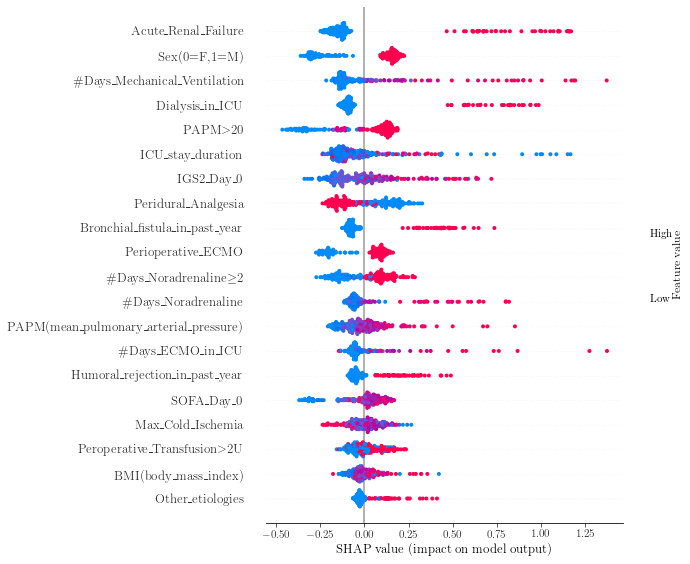

In [322]:
shap.summary_plot(shap_valuesTT, X2);
plt.rcParams.update({'font.size': 20, "font.weight": "bold"})

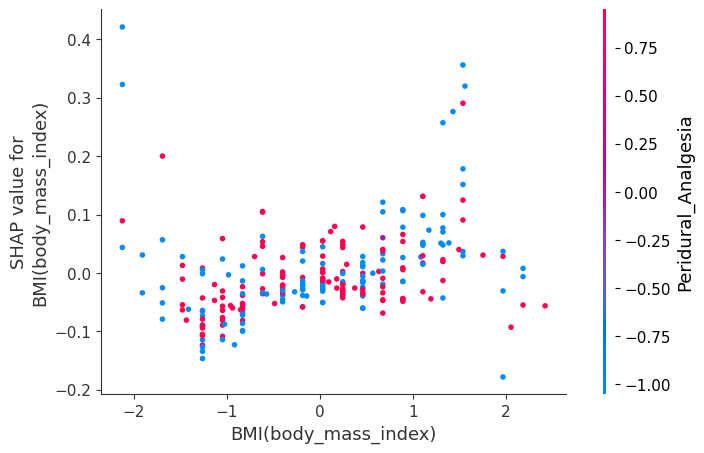

In [487]:
shap.dependence_plot("BMI(body_mass_index)", shap_valuesTT, X2)

In [229]:
#import warnings
#warnings.filterwarnings("ignore")
#pd.set_option('display.max_columns', None)
#plt.style.use("cyberpunk")

# runtime configuration of matplotlib
#plt.rc("figure", 
 #   autolayout=False, 
 #   figsize=(20, 10),
#)
#plt.rc(
 #   "axes",
 #  labelweight="bold",
 #   labelsize="large",
 #   titleweight="bold",
 #   titlesize=20,
 #   titlepad=10,
#)

In [658]:
import warnings

import matplotlib.pyplot as plt

from sklearn.neural_network import MLPClassifier
from sklearn.preprocessing import MinMaxScaler
from sklearn import datasets
from sklearn.exceptions import ConvergenceWarning

# different learning rate schedules and momentum parameters
params = [
    {
        "solver": "sgd",
        "learning_rate": "constant",
        "momentum": 0,
        "learning_rate_init": 0.2,
    },
    {
        "solver": "sgd",
        "learning_rate": "constant",
        "momentum": 0.9,
        "nesterovs_momentum": False,
        "learning_rate_init": 0.2,
    },
    {
        "solver": "sgd",
        "learning_rate": "constant",
        "momentum": 0.9,
        "nesterovs_momentum": True,
        "learning_rate_init": 0.2,
    },
    {
        "solver": "sgd",
        "learning_rate": "invscaling",
        "momentum": 0,
        "learning_rate_init": 0.2,
    },
    {
        "solver": "sgd",
        "learning_rate": "invscaling",
        "momentum": 0.9,
        "nesterovs_momentum": True,
        "learning_rate_init": 0.2,
    },
    {
        "solver": "sgd",
        "learning_rate": "invscaling",
        "momentum": 0.9,
        "nesterovs_momentum": False,
        "learning_rate_init": 0.2,
    },
    {"solver": "adam", "learning_rate_init": 0.01},
]

labels2 = [
    "constant learning-rate",
    "constant with momentum",
    "constant with Nesterov's momentum",
    "inv-scaling learning-rate",
    "inv-scaling with momentum",
    "inv-scaling with Nesterov's momentum",
    "adam",
]

plot_args = [
    {"c": "red", "linestyle": "-"},
    {"c": "green", "linestyle": "-"},
    {"c": "blue", "linestyle": "-"},
    {"c": "red", "linestyle": "--"},
    {"c": "green", "linestyle": "--"},
    {"c": "blue", "linestyle": "--"},
    {"c": "black", "linestyle": "-"},
]



learning on dataset Y1 risk of mortality
training: constant learning-rate
Training set score: 1.000000
Training set loss: 0.008143
training: constant with momentum
Training set score: 1.000000
Training set loss: 0.002257
training: constant with Nesterov's momentum
Training set score: 1.000000
Training set loss: 0.002436
training: inv-scaling learning-rate
Training set score: 0.826000
Training set loss: 0.410100
training: inv-scaling with momentum
Training set score: 0.938000
Training set loss: 0.186802
training: inv-scaling with Nesterov's momentum
Training set score: 0.941000
Training set loss: 0.186324
training: adam
Training set score: 1.000000
Training set loss: 0.002133


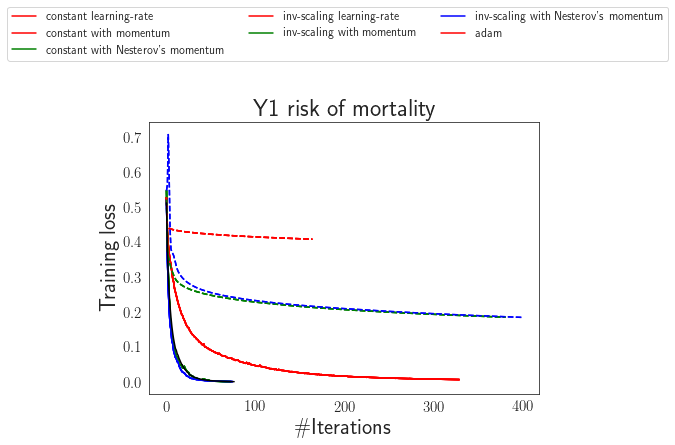

In [692]:
def plot_on_dataset(X, y, ax, name):
    # for each dataset, plot learning for each learning strategy
    print("\nlearning on dataset %s" % name)
    ax.set_title(name, fontsize=24)
    ax.set_xlabel("\#Iterations", fontsize=22)
    ax.set_ylabel("Training loss", fontsize=22)

    mlps = []
    if name == "digits":
        # digits is larger but converges fairly quickly
        max_iter = 15
    else:
        max_iter = 400

    for label, param in zip(labels2, params):
        print("training: %s" % label)
        mlp = MLPClassifier(random_state=89, max_iter=max_iter, **param)
        
        # some parameter combinations will not converge as can be seen on the
        # plots so they are ignored here
        with warnings.catch_warnings():
            warnings.filterwarnings(
                "ignore", category=ConvergenceWarning, module="sklearn"
            ) 
            mlp.fit(X, y)
            mlps.append(mlp)
            print("Training set score: %f" % mlp.score(X, y))
            print("Training set loss: %f" % mlp.loss_)
        for mlp, label, args in zip(mlps, labels2, plot_args):
            ax.plot(mlp.loss_curve_, label=label, **args)

fig, ax = plt.subplots(figsize=(7, 5))

for data, name in zip([(X, y)], ["Y1 risk of mortality"]):
    plot_on_dataset(*data, ax=ax, name=name)

# Add legend with smaller fontsize
fig.legend(ax.get_lines(), labels2, ncol=3, loc="upper center", bbox_to_anchor=(0.5, 1.2), borderaxespad=0, fontsize=12)
ax.tick_params(axis='both', labelsize=15)  # set the fontsize for both x and y ticks
#legend.set_title(prop={'size': fig.dpi/8})

plt.savefig('learning_strategy_MLP+persistence.pdf', dpi=300, bbox_inches='tight')
plt.show()

Based on the provided information, the best result for learning on dataset Y1 risk of mortality was achieved using the training algorithm with constant learning rate and momentum, with a perfect training set score of 1.000 and a training set loss of 0.002. The algorithms with Nesterov's momentum also produced similar results, with a training set score of 1.000 and a training set loss of 0.002 for constant learning rate and 0.186 for inv-scaling learning rate. The Adam optimizer also produced a perfect training set score of 1.000 and a training set loss of 0.002. However, the inv-scaling learning rate algorithm without momentum had a lower training set score of 0.826 and a higher training set loss of 0.410.

In [57]:
#The final step is to combine our feature extraction step with a classifier, fit the pipeline, and extract the OOB score:
from sklearn.gaussian_process import GaussianProcessClassifier #0.79, 0.66 Adaboost 
from sklearn.gaussian_process.kernels import RBF
from sklearn.neighbors import KNeighborsClassifier # 0.8253
from sklearn.naive_bayes import GaussianNB #0.8253
from sklearn.tree import DecisionTreeClassifier #0.76
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis #collinear variables, 0.80952
from gtda.pipeline import Pipeline

pipe = Pipeline(
    [
        ("features", feature_union),
        ("rf",  QuadraticDiscriminantAnalysis()),
        
    ]
)

X_train, X_valid, labels_train, labels_valid = train_test_split(persistence_diagrams, labels, random_state=89)

pipe.fit(X_train, labels_train)
pipe.score(X_valid, labels_valid)


/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:808: UserWarning:

Variables are collinear



0.8095238095238095

In [1650]:
keep = list()
for i in range(252):
    flatten_arr = np.ravel(persistence_diagrams_h1[i])
    # Check if all value in 2D array are equal
    result = np.all(persistence_diagrams_h1[i]==flatten_arr[0])
    if result:
        keep.append(i)
    

In [1347]:
keep_ok = list(set(list(range(252)))-set(keep))

In [1177]:
phate_operator.set_params(knn=4, decay=12, t=9)
Y_phate_imgs_185 = phate_operator.fit_transform(imgs[185])

Calculating PHATE...
  Running PHATE on 267 observations and 92 variables.
  Calculating graph and diffusion operator...
    Calculating KNN search...
    Calculated KNN search in 0.23 seconds.
    Calculating affinities...
    Calculated affinities in 0.10 seconds.
  Calculated graph and diffusion operator in 0.39 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 0.11 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 5.27 seconds.
Calculated PHATE in 5.90 seconds.


In [1147]:
phate_operator.set_params(knn=4, decay=12, t=9)
Y_phate_imgs_188 = phate_operator.fit_transform(imgs[188])

Calculating PHATE...
  Running PHATE on 267 observations and 92 variables.
  Calculating graph and diffusion operator...
    Calculating KNN search...
    Calculated KNN search in 0.11 seconds.
    Calculating affinities...
    Calculated affinities in 0.02 seconds.
  Calculated graph and diffusion operator in 0.15 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 0.01 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 7.10 seconds.
Calculated PHATE in 7.28 seconds.


In [1148]:
phate_operator.set_params(knn=4, decay=12, t=9)
Y_phate_imgs_189 = phate_operator.fit_transform(imgs[189])

Calculating PHATE...
  Running PHATE on 267 observations and 92 variables.
  Calculating graph and diffusion operator...
    Calculating KNN search...
    Calculated KNN search in 0.12 seconds.
    Calculating affinities...
    Calculated affinities in 0.02 seconds.
  Calculated graph and diffusion operator in 0.16 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 0.12 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 1.47 seconds.
Calculated PHATE in 1.81 seconds.


In [1163]:
phate_operator.set_params(knn=4, decay=12, t=9)
Y_phate_imgs_251 = phate_operator.fit_transform(imgs[251])

Calculating PHATE...
  Running PHATE on 267 observations and 92 variables.
  Calculating graph and diffusion operator...
    Calculating KNN search...
    Calculated KNN search in 0.12 seconds.
    Calculating affinities...
    Calculated affinities in 0.01 seconds.
  Calculated graph and diffusion operator in 0.15 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 0.03 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 4.97 seconds.
Calculated PHATE in 5.17 seconds.


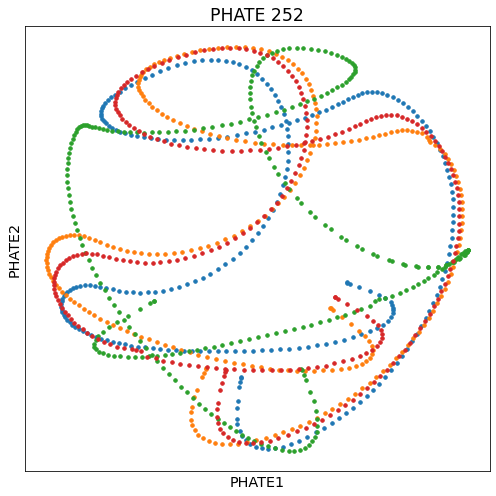

In [1176]:
# plot together some few persistence images
import matplotlib.pyplot as plt
fig, ax1 = plt.subplots(1,1, figsize=(7, 7))

#sample_labels = np.rep([0,1],267)

#plotting Y1 survivor one (sample 0)
scprep.plot.scatter2d(Y_phate_imgs_0, label_prefix="PHATE", title="PHATE 1",
                       ticks=False, cmap='Spectral', ax=ax1)

#plotting Y1 last survivor sample (188)
scprep.plot.scatter2d(Y_phate_imgs_188, label_prefix="PHATE", title="PHATE 189", legend=False,
                       ticks=False, cmap='Spectral', ax=ax1)

#plotting Y1 first non-survivor sample (189)
scprep.plot.scatter2d(Y_phate_imgs_189, label_prefix="PHATE", title="PHATE 190", legend=False,
                       ticks=False, cmap='Spectral', ax=ax1)

#plotting Y1 last non-survivor sample (251)
scprep.plot.scatter2d(Y_phate_imgs_251, label_prefix="PHATE", title="PHATE 252", legend=False,
                       ticks=False, cmap='Spectral', ax=ax1)

plt.tight_layout()
plt.show()

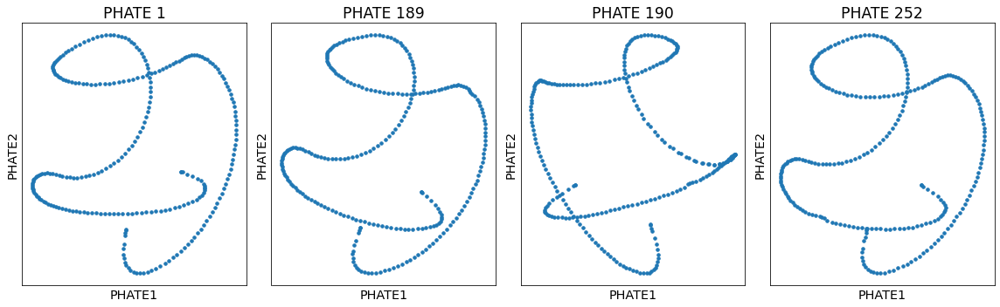

In [1262]:
# plot together some few persistence images
import matplotlib.pyplot as plt
fig, (ax1, ax2, ax3, ax4) = plt.subplots(1,4, figsize=(16, 5))

#sample_labels = np.rep([0,1],267)

#plotting Y1 survivor one (sample 0)
scprep.plot.scatter2d(Y_phate_imgs_0, label_prefix="PHATE", title="PHATE 1",
                       ticks=False, cmap='Spectral', ax=ax1)

#plotting Y1 last survivor sample (188)
scprep.plot.scatter2d(Y_phate_imgs_188, label_prefix="PHATE", title="PHATE 189", legend=False,
                       ticks=False, cmap='Spectral', ax=ax2)

#plotting Y1 first non-survivor sample (189)
scprep.plot.scatter2d(Y_phate_imgs_189, label_prefix="PHATE", title="PHATE 190", legend=False,
                       ticks=False, cmap='Spectral', ax=ax3)

#plotting Y1 last non-survivor sample (251)
scprep.plot.scatter2d(Y_phate_imgs_251, label_prefix="PHATE", title="PHATE 252", legend=False,
                       ticks=False, cmap='Spectral', ax=ax4)

plt.tight_layout()
plt.show()

In [1287]:
Y_phate_imgs = list()
phate_operator.set_params(knn=4, decay=12, t=9)
for i in range(252):
    flatten_arr = np.ravel(persistence_diagrams_h1[i])
    # Check if all value in 2D array are equal
    result = np.all(persistence_diagrams_h1[i]==flatten_arr[0])
    if not result:
        value = phate_operator.fit_transform(imgs[i], njobs=-2)
        Y_phate_imgs.append(value)
    

Calculating PHATE...
  Running PHATE on 267 observations and 92 variables.
  Calculating graph and diffusion operator...
    Calculating KNN search...
    Calculated KNN search in 0.12 seconds.
    Calculating affinities...
    Calculated affinities in 0.02 seconds.
  Calculated graph and diffusion operator in 0.15 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 0.02 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 5.37 seconds.
Calculated PHATE in 5.57 seconds.
Calculating PHATE...
  Running PHATE on 267 observations and 92 variables.
  Calculating graph and diffusion operator...
    Calculating KNN search...
    Calculated KNN search in 0.16 seconds.
    Calculating affinities...
    Calculated affinities in 0.01 seconds.
  Calculated graph and diffusion operator in 0.20 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 0.06 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 5.20 seconds.
Ca

Calculating PHATE...
  Running PHATE on 267 observations and 92 variables.
  Calculating graph and diffusion operator...
    Calculating KNN search...
    Calculated KNN search in 0.12 seconds.
    Calculating affinities...
  Calculated graph and diffusion operator in 0.13 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 0.01 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 8.18 seconds.
Calculated PHATE in 8.34 seconds.
Calculating PHATE...
  Running PHATE on 267 observations and 92 variables.
  Calculating graph and diffusion operator...
    Calculating KNN search...
    Calculated KNN search in 0.11 seconds.
    Calculating affinities...
  Calculated graph and diffusion operator in 0.12 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 0.01 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 5.52 seconds.
Calculated PHATE in 5.67 seconds.
Calculating PHATE...
  Running PHATE on 267 observatio

    Calculated KNN search in 0.11 seconds.
    Calculating affinities...
  Calculated graph and diffusion operator in 0.14 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 0.02 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 6.32 seconds.
Calculated PHATE in 6.49 seconds.
Calculating PHATE...
  Running PHATE on 267 observations and 92 variables.
  Calculating graph and diffusion operator...
    Calculating KNN search...
    Calculated KNN search in 0.11 seconds.
    Calculating affinities...
  Calculated graph and diffusion operator in 0.13 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 0.01 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 5.83 seconds.
Calculated PHATE in 6.00 seconds.
Calculating PHATE...
  Running PHATE on 267 observations and 92 variables.
  Calculating graph and diffusion operator...
    Calculating KNN search...
    Calculated KNN search in 0.11 seconds.
    Calcula

    Calculating affinities...
  Calculated graph and diffusion operator in 0.14 seconds.
  Calculating diffusion potential...
  Calculating metric MDS...
  Calculated metric MDS in 7.91 seconds.
Calculated PHATE in 8.10 seconds.
Calculating PHATE...
  Running PHATE on 267 observations and 92 variables.
  Calculating graph and diffusion operator...
    Calculating KNN search...
    Calculated KNN search in 0.11 seconds.
    Calculating affinities...
    Calculated affinities in 0.01 seconds.
  Calculated graph and diffusion operator in 0.14 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 0.02 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 5.37 seconds.
Calculated PHATE in 5.56 seconds.
Calculating PHATE...
  Running PHATE on 267 observations and 92 variables.
  Calculating graph and diffusion operator...
    Calculating KNN search...
    Calculated KNN search in 0.11 seconds.
    Calculating affinities...
  Calculated graph and diffusio

Calculated PHATE in 20.95 seconds.
Calculating PHATE...
  Running PHATE on 267 observations and 92 variables.
  Calculating graph and diffusion operator...
    Calculating KNN search...
    Calculated KNN search in 0.11 seconds.
    Calculating affinities...
  Calculated graph and diffusion operator in 0.15 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 0.02 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 12.10 seconds.
Calculated PHATE in 12.29 seconds.
Calculating PHATE...
  Running PHATE on 267 observations and 92 variables.
  Calculating graph and diffusion operator...
    Calculating KNN search...
    Calculated KNN search in 0.11 seconds.
    Calculating affinities...
    Calculated affinities in 0.02 seconds.
  Calculated graph and diffusion operator in 0.16 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 0.09 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 30.84 seconds.
Calcula

    Calculating affinities...
  Calculated graph and diffusion operator in 0.12 seconds.
  Calculating diffusion potential...
  Calculating metric MDS...
  Calculated metric MDS in 2.32 seconds.
Calculated PHATE in 2.47 seconds.
Calculating PHATE...
  Running PHATE on 267 observations and 92 variables.
  Calculating graph and diffusion operator...
    Calculating KNN search...
    Calculated KNN search in 0.11 seconds.
    Calculating affinities...
  Calculated graph and diffusion operator in 0.13 seconds.
  Calculating diffusion potential...
  Calculating metric MDS...
  Calculated metric MDS in 7.74 seconds.
Calculated PHATE in 7.88 seconds.
Calculating PHATE...
  Running PHATE on 267 observations and 92 variables.
  Calculating graph and diffusion operator...
    Calculating KNN search...
    Calculated KNN search in 0.11 seconds.
    Calculating affinities...
  Calculated graph and diffusion operator in 0.13 seconds.
  Calculating diffusion potential...
  Calculating metric MDS...


  Calculating graph and diffusion operator...
    Calculating KNN search...
    Calculated KNN search in 0.15 seconds.
    Calculating affinities...
    Calculated affinities in 0.08 seconds.
  Calculated graph and diffusion operator in 0.28 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 0.02 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 40.32 seconds.
Calculated PHATE in 40.73 seconds.
Calculating PHATE...
  Running PHATE on 267 observations and 92 variables.
  Calculating graph and diffusion operator...
    Calculating KNN search...
    Calculated KNN search in 0.13 seconds.
    Calculating affinities...
    Calculated affinities in 0.03 seconds.
  Calculated graph and diffusion operator in 0.19 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 0.02 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 7217.08 seconds.
Calculated PHATE in 7217.33 seconds.
Calculating PHATE...
  Running PHAT

Calculated PHATE in 8.14 seconds.
Calculating PHATE...
  Running PHATE on 267 observations and 92 variables.
  Calculating graph and diffusion operator...
    Calculating KNN search...
    Calculated KNN search in 0.12 seconds.
    Calculating affinities...
  Calculated graph and diffusion operator in 0.15 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 0.02 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 8.41 seconds.
Calculated PHATE in 8.62 seconds.
Calculating PHATE...
  Running PHATE on 267 observations and 92 variables.
  Calculating graph and diffusion operator...
    Calculating KNN search...
    Calculated KNN search in 0.11 seconds.
    Calculating affinities...
  Calculated graph and diffusion operator in 0.12 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 0.01 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 8.97 seconds.
Calculated PHATE in 9.12 seconds.
Calculating PHATE...

    Calculating affinities...
    Calculated affinities in 0.01 seconds.
  Calculated graph and diffusion operator in 0.13 seconds.
  Calculating diffusion potential...
  Calculating metric MDS...
  Calculated metric MDS in 4.57 seconds.
Calculated PHATE in 4.72 seconds.
Calculating PHATE...
  Running PHATE on 267 observations and 92 variables.
  Calculating graph and diffusion operator...
    Calculating KNN search...
    Calculated KNN search in 0.11 seconds.
    Calculating affinities...
  Calculated graph and diffusion operator in 0.13 seconds.
  Calculating diffusion potential...
  Calculating metric MDS...
  Calculated metric MDS in 5.39 seconds.
Calculated PHATE in 5.54 seconds.
Calculating PHATE...
  Running PHATE on 267 observations and 92 variables.
  Calculating graph and diffusion operator...
    Calculating KNN search...
    Calculated KNN search in 0.11 seconds.
    Calculating affinities...
  Calculated graph and diffusion operator in 0.12 seconds.
  Calculating diffusio

  Calculating diffusion potential...
  Calculated diffusion potential in 0.01 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 8.14 seconds.
Calculated PHATE in 8.30 seconds.
Calculating PHATE...
  Running PHATE on 267 observations and 92 variables.
  Calculating graph and diffusion operator...
    Calculating KNN search...
    Calculated KNN search in 0.11 seconds.
    Calculating affinities...
    Calculated affinities in 0.01 seconds.
  Calculated graph and diffusion operator in 0.13 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 0.01 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 8.32 seconds.
Calculated PHATE in 8.48 seconds.
Calculating PHATE...
  Running PHATE on 267 observations and 92 variables.
  Calculating graph and diffusion operator...
    Calculating KNN search...
    Calculated KNN search in 0.11 seconds.
    Calculating affinities...
  Calculated graph and diffusion operator in 0.13 seconds.
  Calculati

  Running PHATE on 267 observations and 92 variables.
  Calculating graph and diffusion operator...
    Calculating KNN search...
    Calculated KNN search in 0.11 seconds.
    Calculating affinities...
  Calculated graph and diffusion operator in 0.13 seconds.
  Calculating diffusion potential...
  Calculating metric MDS...
  Calculated metric MDS in 8.09 seconds.
Calculated PHATE in 8.25 seconds.
Calculating PHATE...
  Running PHATE on 267 observations and 92 variables.
  Calculating graph and diffusion operator...
    Calculating KNN search...
    Calculated KNN search in 0.11 seconds.
    Calculating affinities...
  Calculated graph and diffusion operator in 0.12 seconds.
  Calculating diffusion potential...
  Calculating metric MDS...
  Calculated metric MDS in 5.34 seconds.
Calculated PHATE in 5.48 seconds.
Calculating PHATE...
  Running PHATE on 267 observations and 92 variables.
  Calculating graph and diffusion operator...
    Calculating KNN search...
    Calculated KNN searc

Calculating PHATE...
  Running PHATE on 267 observations and 92 variables.
  Calculating graph and diffusion operator...
    Calculating KNN search...
    Calculated KNN search in 0.11 seconds.
    Calculating affinities...
  Calculated graph and diffusion operator in 0.12 seconds.
  Calculating diffusion potential...
  Calculating metric MDS...
  Calculated metric MDS in 8.78 seconds.
Calculated PHATE in 8.93 seconds.
Calculating PHATE...
  Running PHATE on 267 observations and 92 variables.
  Calculating graph and diffusion operator...
    Calculating KNN search...
    Calculated KNN search in 0.11 seconds.
    Calculating affinities...
    Calculated affinities in 0.01 seconds.
  Calculated graph and diffusion operator in 0.14 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 0.01 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 6.49 seconds.
Calculated PHATE in 6.65 seconds.
Calculating PHATE...
  Running PHATE on 267 observations and 

  Calculating diffusion potential...
  Calculated diffusion potential in 0.01 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 9.94 seconds.
Calculated PHATE in 10.12 seconds.
Calculating PHATE...
  Running PHATE on 267 observations and 92 variables.
  Calculating graph and diffusion operator...
    Calculating KNN search...
    Calculated KNN search in 0.11 seconds.
    Calculating affinities...
    Calculated affinities in 0.01 seconds.
  Calculated graph and diffusion operator in 0.14 seconds.
  Calculating diffusion potential...
  Calculating metric MDS...
  Calculated metric MDS in 9.68 seconds.
Calculated PHATE in 9.85 seconds.
Calculating PHATE...
  Running PHATE on 267 observations and 92 variables.
  Calculating graph and diffusion operator...
    Calculating KNN search...
    Calculated KNN search in 0.13 seconds.
    Calculating affinities...
    Calculated affinities in 0.01 seconds.
  Calculated graph and diffusion operator in 0.16 seconds.
  Calculating dif

  Running PHATE on 267 observations and 92 variables.
  Calculating graph and diffusion operator...
    Calculating KNN search...
    Calculated KNN search in 0.12 seconds.
    Calculating affinities...
  Calculated graph and diffusion operator in 0.14 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 0.05 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 7.23 seconds.
Calculated PHATE in 7.47 seconds.


In [1296]:
len(Y_phate_imgs)
Y_phate_imgs[0].shape

(267, 3)

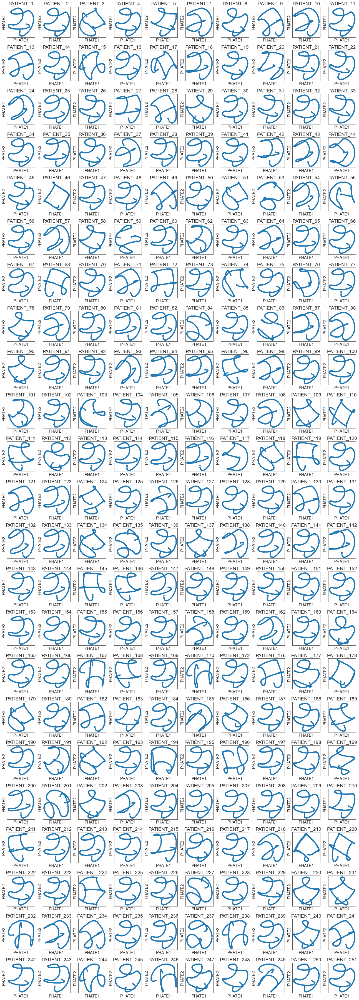

In [1552]:
import matplotlib.pyplot as plt

ax = tuple(['ax'+str(x) for x in range(230)])
    
fig, ax = plt.subplots(23,10, figsize=(18, 50))

#sample_labels = np.rep([0,1],267)
for i in range(230):
    scprep.plot.scatter2d(Y_phate_imgs[i], label_prefix="PHATE", title="PATIENT_"+str(keep_ok[i]),
                       ticks=False, cmap='Spectral', ax=ax.flatten()[i])
plt.tight_layout()
#plt.show()
plt.savefig('PIs_trajectories.pdf', dpi=300, bbox_inches='tight')

In [1122]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(imgs_array, labels, test_size=0.4, random_state=42)

In [1123]:
lr = LogisticRegression()
lr.fit(X_train, y_train)

LogisticRegression()

In [1124]:
lr.score(X_test, y_test)

0.7821782178217822

In [89]:
!pip install --user --upgrade phate scprep

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 93.8/93.8 kB 4.4 MB/s eta 0:00:00
  Attempting uninstall: scprep
    Found existing installation: scprep 1.2.0
    Uninstalling scprep-1.2.0:
      Successfully uninstalled scprep-1.2.0


In [90]:
import phate
import scprep

# matplotlib settings for Jupyter notebooks only
%matplotlib inline

AttributeError: module 'natsort' has no attribute 'compat'

In [333]:
phate_operator = phate.PHATE(n_jobs=-1)
#test = M.drop(['NIP_(identifiant)', 'date_de_TP', 'mortalité_à_un_an'], axis=1)
test = df2_standard_scale
#test = test.replace(np.nan, 0)
#Standarisation
#from sklearn.preprocessing import StandardScaler
#test_standard_scale=pd.DataFrame(StandardScaler().fit_transform(test))
#Y_phate = phate_operator.fit_transform(test_standard_scale)
Y_phate = phate_operator.fit_transform(test)

Calculating PHATE...
  Running PHATE on 252 observations and 52 variables.
  Calculating graph and diffusion operator...
    Calculating KNN search...
    Calculated KNN search in 0.11 seconds.
    Calculating affinities...
  Calculated graph and diffusion operator in 0.12 seconds.
  Calculating optimal t...
    Automatically selected t = 22
  Calculated optimal t in 0.14 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 0.01 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 0.07 seconds.
Calculated PHATE in 0.37 seconds.


In [326]:
ycat = y2.copy();
ycat.iloc[ycat==0]='Y1 survivor'
ycat.iloc[ycat==1]='Y1 non-survivor'
ycat

NOM
Abdalla                Y1 survivor
ABDAT                  Y1 survivor
AHMED                  Y1 survivor
AIT ALI                Y1 survivor
ALAZARD                Y1 survivor
                          ...     
VISEUR                 Y1 survivor
WEYRECH                Y1 survivor
Williez Dangauthier    Y1 survivor
Yahiaoui               Y1 survivor
YEBBOU                 Y1 survivor
Name: one_year_mortality, Length: 252, dtype: object

<AxesSubplot:xlabel='PHATE1', ylabel='PHATE2'>

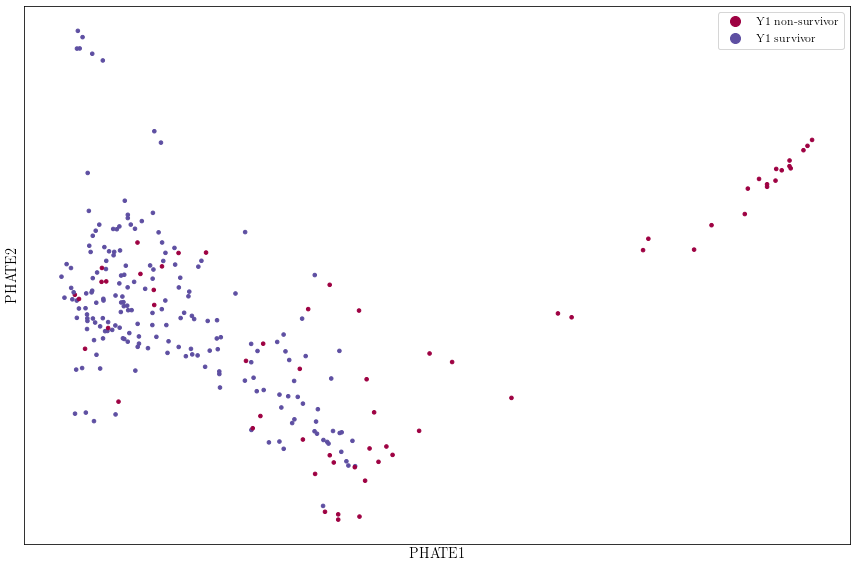

In [327]:
scprep.plot.scatter2d(Y_phate, c=ycat, figsize=(12,8), cmap="Spectral",
                      ticks=False, label_prefix="PHATE")

In [328]:
phate_operator.set_params(knn=4, decay=15, t=12)
# We could also create a new operator:
# phate_operator = phate.PHATE(knn=4, decay=15, t=12, n_jobs=-2)

Y_phate = phate_operator.fit_transform(test)

Calculating PHATE...
  Running PHATE on 252 observations and 52 variables.
  Calculating graph and diffusion operator...
    Calculating KNN search...
    Calculated KNN search in 0.11 seconds.
    Calculating affinities...
    Calculated affinities in 0.12 seconds.
  Calculated graph and diffusion operator in 0.24 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 0.02 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 0.07 seconds.
Calculated PHATE in 0.34 seconds.


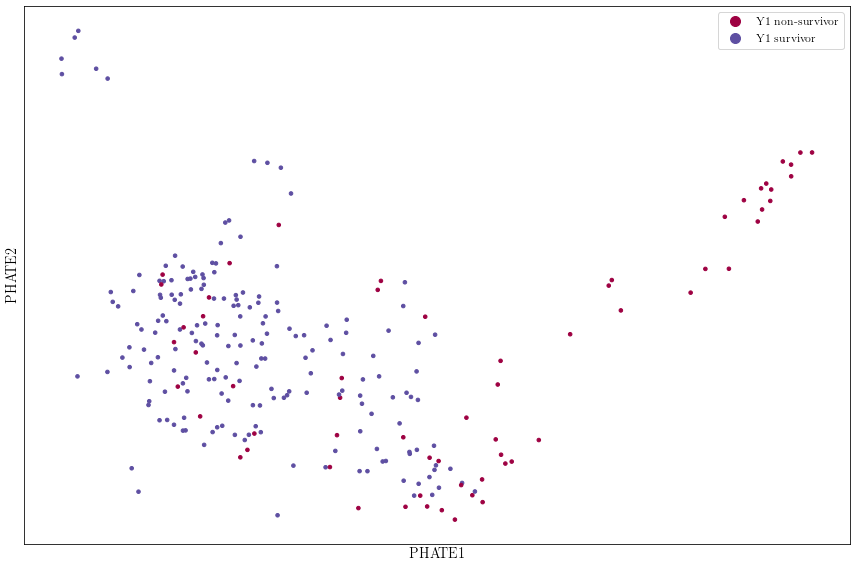

In [329]:
scprep.plot.scatter2d(Y_phate, c=ycat, figsize=(12,8), cmap="Spectral",
                      ticks=False, label_prefix="PHATE")
plt.savefig('database_phate2_visualisation_clust.pdf', dpi=300, bbox_inches='tight')

Calculating metric MDS...
Calculated metric MDS in 0.95 seconds.


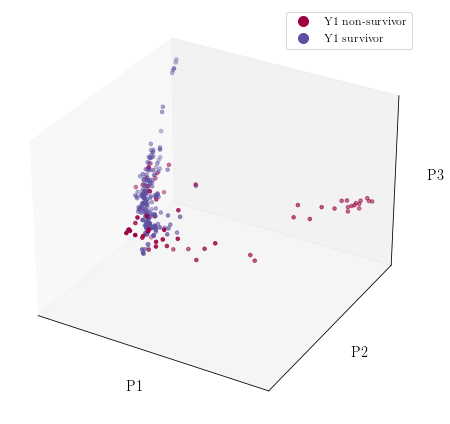

In [334]:
phate_operator.set_params(n_components=3)
Y_phate_3d = phate_operator.transform()
scprep.plot.scatter3d(Y_phate_3d, c=ycat, figsize=(8,6), cmap="Spectral",
                      ticks=False, label_prefix="P")
plt.savefig('database_phate2_visualisation_clust_3D.pdf', dpi=300, bbox_inches='tight')

In [335]:
scprep.plot.rotate_scatter3d(Y_phate_3d, c=ycat, 
                             figsize=(8,6), cmap="Spectral",
                             ticks=False, label_prefix="P", filename="database_phate2_visualisation_clust_3D.mp4")

In [362]:
!pip install --user --upgrade umap-learn

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.8/86.8 KB 364.6 kB/s eta 0:00:00a 0:00:01
  Preparing metadata (setup.py) ... done
  Created wheel for umap-learn: filename=umap_learn-0.5.2-py3-none-any.whl size=82696 sha256=faaa56f5ac00d1c9fdae00e4a7680f56ab09a9eccc5af026338cd31745e69e3f
  Stored in directory: /Users/morilla/Library/Caches/pip/wheels/84/1b/c6/aaf68a748122632967cef4dffef68224eb16798b6793257d82
Successfully built umap-learn
  Attempting uninstall: umap-learn
    Found existing installation: umap-learn 0.5.1
    Uninstalling umap-learn-0.5.1:
      Successfully uninstalled umap-learn-0.5.1


In [337]:
import sklearn.decomposition # PCA
import sklearn.manifold # t-SNE
import umap.umap_ as umap # UMAP
import time

start = time.time()
pca_operator = sklearn.decomposition.PCA(n_components=2)
Y_pca = pca_operator.fit_transform(np.array(test))
end = time.time()
print("Embedded PCA in {:.2f} seconds.".format(end-start))

start = time.time()
pca_operator = sklearn.decomposition.PCA(n_components=43)
tsne_operator = sklearn.manifold.TSNE(n_components=2)
Y_tsne = tsne_operator.fit_transform(pca_operator.fit_transform(np.array(test)))
end = time.time()
print("Embedded t-SNE in {:.2f} seconds.".format(end-start))

start = time.time()
pca_operator = sklearn.decomposition.PCA(n_components=43)
umap_operator = umap.UMAP(n_components=2)
Y_umap = umap_operator.fit_transform(pca_operator.fit_transform(np.array(test)))
end = time.time()
print("Embedded UMAP in {:.2f} seconds.".format(end-start))

Embedded PCA in 0.00 seconds.
Embedded t-SNE in 1.64 seconds.


OMP: Info #270: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


Embedded UMAP in 9.66 seconds.


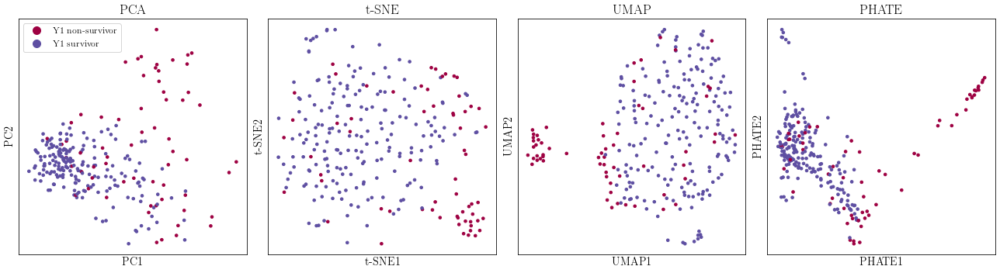

In [339]:
# plot everything
import matplotlib.pyplot as plt
fig, (ax1, ax2, ax3, ax4) = plt.subplots(1,4, figsize=(18, 5))

#plotting PCA
scprep.plot.scatter2d(Y_pca, label_prefix="PC", title="PCA",
                      c=ycat, ticks=False, cmap='Spectral', ax=ax1)

#plotting tSNE
scprep.plot.scatter2d(Y_tsne, label_prefix="t-SNE", title="t-SNE", legend=False,
                      c=ycat, ticks=False, cmap='Spectral', ax=ax2)

#plotting UMAP
scprep.plot.scatter2d(Y_umap, label_prefix="UMAP", title="UMAP", legend=False,
                      c=ycat, ticks=False, cmap='Spectral', ax=ax3)

#plotting PHATE
scprep.plot.scatter2d(Y_phate, label_prefix="PHATE", title="PHATE", legend=False,
                      c=ycat, ticks=False, cmap='Spectral', ax=ax4)

plt.tight_layout()
plt.show()

In [374]:
!pip install --user --upgrade graphtools

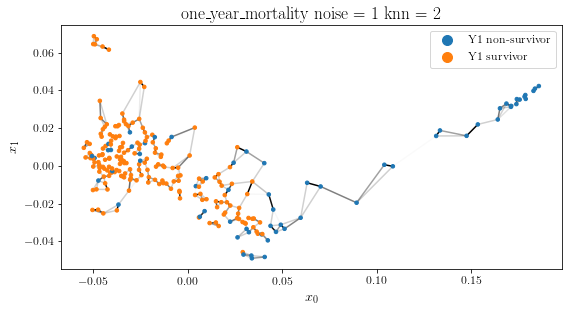

In [354]:
#========
dataset_name = 'one_year_mortality'
#knns = [2, 5, 10]
#for knn in knns:
G = gt.Graph(Y_phate, knn=2)


# ======
# Plotting the graph
# ======

# This code draws the nodes of the graph
ax = scprep.plot.scatter2d(Y_phate, c=ycat, 
              xlabel='$x_{0}$', ylabel='$x_{1}$',
              title= dataset_name + " noise = " + str(1) + " knn = " + str(2), figsize=(8,6),
              legend=True)

# This block of code draws lines between each point and its neighbors
for i in range(Y_phate.shape[0]-1):
    for j in range(i+1, Y_phate.shape[0]):
        affinity = G.kernel[i,j]
        if affinity > 0:
            ax.plot(Y_phate[[i,j],0], Y_phate[[i,j],1],
                    color='black', alpha=affinity, zorder=0)
    
    ax.set_aspect(1) 
    plt.tight_layout()

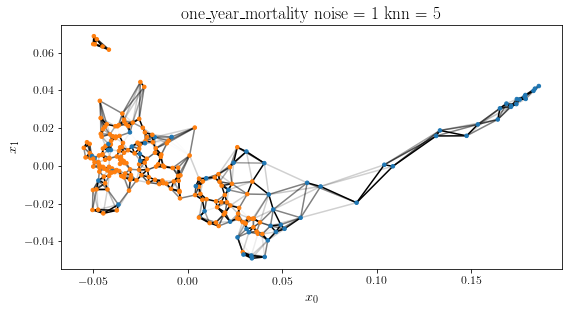

In [348]:
import graphtools as gt

#========
dataset_name = 'one_year_mortality'
#knns = [2, 5, 10]
#for knn in knns:
G = gt.Graph(Y_phate, knn=5)


# ======
# Plotting the graph
# ======

# This code draws the nodes of the graph
ax = scprep.plot.scatter2d(Y_phate, c=ycat, 
              xlabel='$x_{0}$', ylabel='$x_{1}$',
              title= dataset_name + " noise = " + str(1) + " knn = " + str(5), figsize=(8,6),
              legend=False)

# This block of code draws lines between each point and its neighbors
for i in range(Y_phate.shape[0]-1):
    for j in range(i+1, Y_phate.shape[0]):
        affinity = G.kernel[i,j]
        if affinity > 0:
            ax.plot(Y_phate[[i,j],0], Y_phate[[i,j],1],
                    color='black', alpha=affinity, zorder=0)
    
    ax.set_aspect(1) 
    plt.tight_layout()

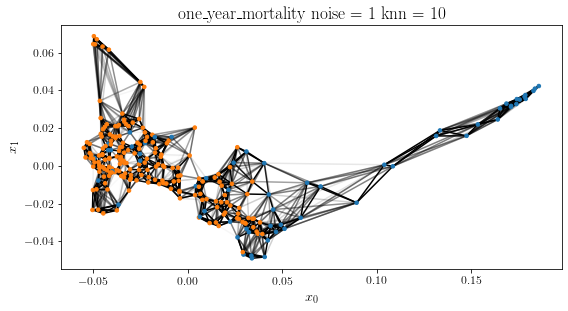

In [350]:
G = gt.Graph(Y_phate, knn=10)


# ======
# Plotting the graph
# ======

# This code draws the nodes of the graph
ax = scprep.plot.scatter2d(Y_phate, c=ycat, 
              xlabel='$x_{0}$', ylabel='$x_{1}$',
              title= dataset_name + " noise = " + str(1) + " knn = " + str(10), figsize=(8,6),
              legend=False)

# This block of code draws lines between each point and its neighbors
for i in range(Y_phate.shape[0]-1):
    for j in range(i+1, Y_phate.shape[0]):
        affinity = G.kernel[i,j]
        if affinity > 0:
            ax.plot(Y_phate[[i,j],0], Y_phate[[i,j],1],
                    color='black', alpha=affinity, zorder=0)
    
    ax.set_aspect(1) 
    plt.tight_layout()

In [388]:
from sklearn.metrics import pairwise_distances
from gtda.diagrams import Scaler, Filtering, PersistenceEntropy, BettiCurve, PairwiseDistance
from gtda.plotting import plot_heatmap
p_L = 2
n_layers = 5
PD = PairwiseDistance(
    metric='landscape', metric_params={'p': p_L, 'n_layers': n_layers, 'n_bins': 1000}, order=None)

X_distance_L = PD.fit_transform(persistence_diagrams)
print(X_distance_L.shape)

(252, 252, 3)


In [356]:
plot_heatmap(X_distance_L[:, :, 1], colorscale='blues')

In [357]:
p_W = 2
PD = PairwiseDistance(
    metric='wasserstein', metric_params={'p': p_W, 'delta': 0.1}, order=None)

X_distance_W = PD.fit_transform(persistence_diagrams)

In [358]:
plot_heatmap(X_distance_W[:, :, 0], colorscale='blues')

In [359]:
p_PI = 2
PD = PairwiseDistance(
    metric='persistence_image', metric_params={'p': p_PI, 'sigma': 0.1, 'n_bins': 100}, order=None)

X_distance_PI = PD.fit_transform(persistence_diagrams)

In [1408]:
plot_heatmap(X_distance_PI[:, :, 0], colorscale='blues')

In [1410]:
X_distance_PI[189:,189:,0]

array([[ 0.        , 19.43014204, 19.23707669, ..., 16.89579119,
        18.27859717, 19.34153486],
       [19.43014204,  0.        , 14.10078823, ..., 11.55785553,
        11.81250088, 12.74508496],
       [19.23707669, 14.10078823,  0.        , ..., 15.92544437,
         7.57034979, 12.1059473 ],
       ...,
       [16.89579119, 11.55785553, 15.92544437, ...,  0.        ,
        13.78060531, 10.13458484],
       [18.27859717, 11.81250088,  7.57034979, ..., 13.78060531,
         0.        , 12.27090496],
       [19.34153486, 12.74508496, 12.1059473 , ..., 10.13458484,
        12.27090496,  0.        ]])

In [360]:
PD = PairwiseDistance(
    metric='bottleneck', metric_params={'delta': 0.1}, order=None)

X_distance_B = PD.fit_transform(persistence_diagrams)

In [1565]:
plot_heatmap(X_distance_B[:, :, 0], colorscale='blues')

In [361]:
#"heat", "silhouette",
p_Bt = 2
PD = PairwiseDistance(
    metric='betti', metric_params={'p': p_W, 'n_bins': 100}, order=None)

X_distance_Bt = PD.fit_transform(persistence_diagrams)